# Automatic Music Transacription: Preprocessing
As is with most ML problems, preprocessing is the crucial part. Dataset consists of audio files with corresponding midi ground truths. Since real models are trained on around 170 audio/midi files, in order to demostrate in detail every step of the preprocessing, this notebook will process one test file and one train file.

In [27]:
import librosa as libr
import librosa.display
import matplotlib.pyplot as plt
import numpy as np
import pretty_midi
import IPython.display as ipd

from sklearn.preprocessing import MinMaxScaler

import os
import sys

sys.path.append("..")
sys.path.append("../src")
from src import constants
%load_ext autoreload
%autoreload 

In [2]:
midi_path_test = '../example_data/test/MIDI-Unprocessed_041_PIANO041_MID--AUDIO-split_07-06-17_Piano-e_1-01_wav--1.midi'
wav_path_test = '../example_data/test/MIDI-Unprocessed_041_PIANO041_MID--AUDIO-split_07-06-17_Piano-e_1-01_wav--1.wav'

midi_path = '../example_data/train/MIDI-Unprocessed_R1_D1-1-8_mid--AUDIO-from_mp3_01_R1_2015_wav--1.midi'
wav_path = '../example_data/train/MIDI-Unprocessed_R1_D1-1-8_mid--AUDIO-from_mp3_01_R1_2015_wav--1.wav'


# midi_file = open(midi_path,'r')
# wav_file = open(wav_path, 'r')
# midi_file_test = open(midi_path_test,'r')
# wav_file_test = open(wav_path_test, 'r')

## step 1: Load and Downsample
We first load and downsample audio to 16kHz. We use Libraosa libabry for this, as well as many step during preprocessing that will come along later.

In [3]:
au_test, sr_test = libr.load(wav_path_test, sr=16000)
ipd.Audio(au_test, rate=sr_test)

In [4]:
au_down, sr_down = libr.load(wav_path, sr=16000)
ipd.Audio(au_down, rate=sr_down)


In [5]:
print(au_down.shape)
print(au_test.shape)

(5857767,)
(2432284,)


## Step 2: Transform audio
We have to transform the sampled audio to a 2d time-frequency representation. <br>
As is the common practice, this is done using Constant Q transform. CQT is well suited for musical signals as it provides frequencies on a logarithmic scale (as are musical signals as well).
There are several parameteres that we have to choose for CQT.<br>
1. we proved minimum and maximum midi numbers, which correspond to first and last keys on the piano: A0 and C8.
2. we also choose the bin numbers, which will correspond to number of frequencies the spectogram will contain. In this case we choose the number of keys on the piano multipllied by a certain multiplier. For now we can set the multiplier to be 1, since all of testing and training will be done on piano. However geenrally it may be suitable to raise the prequency to catch cetrain off-tones or microtones.
3. hop length is he number of samples between successive frames, e.g., the columns of a spectrogram. we choose 512 as this will cause resulting spectogram to contain 31.25 frames per second.
4. bins per octave, as the name suggests will match the numbers of keys on a piano multiplied by a multiplier (1 in our case)

In [8]:
min_midi = 21 # A0
max_midi = 108 # C8
bins_p_octave_mult = 1
bins_p_ocatave = bins_p_octave_mult * 12
fmin = libr.midi_to_hz(min_midi)
n_bins = (max_midi - min_midi + 1) * bins_p_octave_mult


proc_input = libr.cqt(au_down, window='hamming', sr=sr_down, hop_length=512, fmin=fmin, n_bins=n_bins, bins_per_octave=bins_p_ocatave)
proc_input = np.abs(proc_input)
print(proc_input.shape)
#frame amount: 11441. piece length: 366 seconds. frame rate: 11441/366 = 31.25 frame/sec
print(proc_input[:3])

proc_input_test = libr.cqt(au_test, window='hamming', sr=sr_test, hop_length=512, fmin=fmin, n_bins=n_bins, bins_per_octave=bins_p_ocatave)
proc_input_test = np.abs(proc_input_test)
print(proc_input_test.shape)
#frame amount: 4751. piece length: 152 seconds. frame rate: 4751/152 = 31.25 frame/sec
print(proc_input_test[:3])

(88, 11441)
[[1.32091980e-04 1.37447085e-04 1.50967054e-04 ... 8.15505475e-04
  7.68435474e-04 7.26239433e-04]
 [2.74626213e-04 2.73853936e-04 2.80717355e-04 ... 7.00151534e-04
  6.18029519e-04 5.57152254e-04]
 [1.23599381e-04 1.15802860e-04 9.53151624e-05 ... 5.28781066e-04
  4.79027603e-04 4.25959411e-04]]
(88, 4751)
[[0.00081975 0.00092466 0.00117398 ... 0.0022949  0.00240933 0.00245939]
 [0.00196423 0.00203508 0.00206535 ... 0.00213112 0.00131428 0.00042872]
 [0.00100686 0.00126129 0.00176477 ... 0.00376199 0.0036601  0.00362138]]


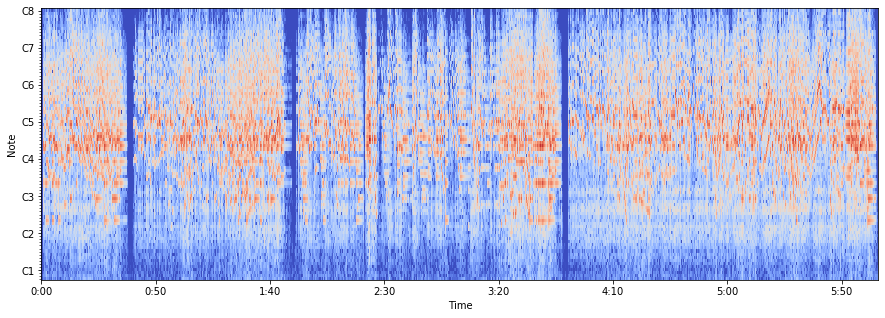

In [9]:
logC = libr.amplitude_to_db(proc_input)
plt.figure(figsize=(15, 5))
libr.display.specshow(logC, sr=sr_down, x_axis='time', y_axis='cqt_note', fmin=fmin, cmap='coolwarm')

In [10]:
proc_input= proc_input.T
proc_input_test = proc_input_test.T
print(proc_input.shape)
print(proc_input_test.shape)

(11441, 88)
(4751, 88)


## Step 3: Scaling
One common form of scaling has been subtracting the mean and dividing by the standard deviation.However, resilts of training have shown that much better results are given using min-max scaler which is computed as:
\begin{equation*}
z_i = \frac{x_i - min(x)}{max(x) - min(x)}
\end{equation*}

In [11]:
mean = np.mean(proc_input, axis=0)
std = np.std(proc_input, axis=0)
print(mean.shape)
print(std.shape)

scaler = MinMaxScaler()
scaler.fit(proc_input)
proc_input_scaled = scaler.transform(proc_input)

scaler.fit(proc_input_test)
#proc_input_norm = proc_input
proc_input_test_scaled = proc_input_test
#print(proc_input_norm.shape)


(88,)
(88,)


In [13]:
x_train = proc_input_scaled
x_test = proc_input_test_scaled
print(x_train.shape)
print(x_test.shape)

(11441, 88)
(4751, 88)


In [15]:
# we use this for matching midi files
times = libr.frames_to_time(np.arange(proc_input_scaled.shape[0]), sr=sr_down, hop_length=512)
times_test = libr.frames_to_time(np.arange(proc_input_test_scaled.shape[0]), sr=sr_test, hop_length=512)

In [16]:
print(times.shape)
print(times_test.shape)

(11441,)
(4751,)


## Step 4: Preprocesing midi 
We must now get piano roll from each midi files. we use pretty midi library to do so. in order to match it up with audio files we pass in "times" argument, which indicates the times of the start of each column in the piano roll. This we got from audio files at the end of the previous step.

In [18]:
pm = pretty_midi.PrettyMIDI(midi_path)
pm_test = pretty_midi.PrettyMIDI(midi_path_test)

In [19]:
piano_roll = pm.get_piano_roll(times=times)[min_midi:max_midi+1].T
print(piano_roll.shape)
piano_roll[piano_roll > 0] = 1
y_train = piano_roll

piano_roll_test = pm_test.get_piano_roll(times=times_test)[min_midi:max_midi+1].T
print(piano_roll_test.shape)
piano_roll_test[piano_roll_test > 0] = 1
y_test = piano_roll_test

(11441, 88)
(4751, 88)


## Step 5: Inspectig results
It would be good for intuition as to what's going on if we visualized the resulting arrays. 

In [20]:
frame_to_inspect = 100

0.22478178602113716


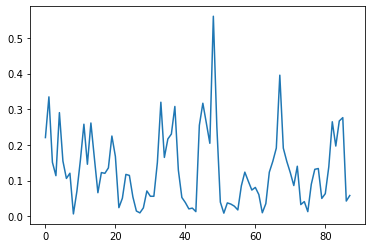

In [21]:
plt.plot(x_train[frame_to_inspect])
print(x_train[frame_to_inspect][19])

In [ ]:
plt.plot(y_train[frame_to_inspect])
print(np.argwhere(y_train[frame_to_inspect] > 0))

As see here frequencies don't necesarrily correspong to actual notes takes at that exact frame. This is due to actual polyphonic piano note onsets not being a descrete event, but the sound actually lasting for some time in the latter frames. This is exactly where machine learning and the poing of this project comes in. A model that is able to learn from individual frame frequencies in context as well as from temporal sequences of frames

## Step 5: Padding
The last step of preprocessing if to pad the resulting arrays which is necesarry for generating data for the models. We do two types of padding
1. Since we will be feeding the frames to the model in sequences of [100 or 128], as defines in src/constants.py, we have to pad both audio and midi to fill it to the multiples of 100.
2. We will be providing each frame in a context window, with central frame being the target one, we have to zero pad the beginning of audio with the half of window size, also defined in constants

In [28]:
to_pad =  int(np.ceil(x_train.shape[0]/constants.SEQUENCE_SIZE) * constants.SEQUENCE_SIZE - x_train.shape[0])
x_train = np.append(x_train, np.zeros((to_pad, x_train.shape[1])), axis = 0)
y_train = np.append(y_train, np.zeros((to_pad, y_train.shape[1])), axis = 0)
print(to_pad)
print(np.zeros((to_pad, x_train.shape[1])).shape)
to_pad = int(np.ceil(x_test.shape[0]/constants.SEQUENCE_SIZE) * constants.SEQUENCE_SIZE - x_test.shape[0])
x_test = np.append(x_test, np.zeros((to_pad, x_test.shape[1])), axis = 0)
y_test = np.append(y_test, np.zeros((to_pad, y_test.shape[1])), axis = 0)
print(to_pad)

print(x_train.shape)
print(y_train.shape)

print(x_test.shape)
print(y_test.shape)

59
(59, 88)
49
(11500, 88)
(11500, 88)
(4800, 88)
(4800, 88)


In [30]:
# add padding to sart and end of piece since we will be processing frames in windows of sice 7 in this case
window_half = constants.CONTEXT_WINDOW_SIZE // 2
print(window_half)
x_train = np.append(x_train, np.zeros((window_half, x_train.shape[1])), axis = 0)
x_train = np.insert(x_train, 0, np.zeros((window_half,  y_train.shape[1])), axis = 0)

x_test = np.append(x_test, np.zeros((window_half, x_test.shape[1])), axis = 0)
x_test = np.insert(x_test, 0, np.zeros((window_half,  y_test.shape[1])), axis = 0)

3


## Step 6: Saving the preprocessed files.
The volumn of files and the sizes of arrays are going to be very large, so we can't have them in memory for training. We will also need to write out own data generator since the means of feeding data into the neural net is going to be specific. Therefore we save the npy arrays on disk, which we will be reading from within data generator

In [31]:
np.save(os.path.join('../train_data_proc','x_0'), x_train)
np.save(os.path.join('../train_data_proc', 'y_0'), y_train)

In [32]:
np.save(os.path.join('../test_data_proc','x_0'), x_test)
np.save(os.path.join('../test_data_proc', 'y_0'), y_test)